# Exploratory Data Analysis - Terrorism

#### Importing Libraries

In [64]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px 
import warnings
warnings.filterwarnings("ignore")

#### Loading Dataset

In [65]:
df = pd.read_csv('globalterrorismdb_0718dist.csv' , encoding = 'ISO-8859-1')

In [66]:
df.shape

(181691, 135)

In [67]:
df.head()

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaN,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaN,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,197001000003,1970,1,0,NaN,0,NaN,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN


In [68]:
df.describe()

,eventid,iyear,imonth,iday,extended,country,region,latitude,longitude,specificity,...,ransomamt,ransomamtus,ransompaid,ransompaidus,hostkidoutcome,nreleased,INT_LOG,INT_IDEO,INT_MISC,INT_ANY
count,1.816910e+05,181691.000000,181691.000000,181691.000000,181691.000000,181691.000000,181691.000000,177135.000000,1.771340e+05,181685.000000,...,1.350000e+03,5.630000e+02,7.740000e+02,552.000000,10991.000000,10400.000000,181691.000000,181691.000000,181691.000000,181691.000000
mean,2.002705e+11,2002.638997,6.467277,15.505644,0.045346,131.968501,7.160938,23.498343,-4.586957e+02,1.451452,...,3.172530e+06,5.784865e+05,7.179437e+05,240.378623,4.629242,-29.018269,-4.543731,-4.464398,0.090010,-3.945952
std,1.325957e+09,13.259430,3.388303,8.814045,0.208063,112.414535,2.933408,18.569242,2.047790e+05,0.995430,...,3.021157e+07,7.077924e+06,1.014392e+07,2940.967293,2.035360,65.720119,4.543547,4.637152,0.568457,4.691325
min,1.970000e+11,1970.000000,0.000000,0.000000,0.000000,4.000000,1.000000,-53.154613,-8.618590e+07,1.000000,...,-9.900000e+01,-9.900000e+01,-9.900000e+01,-99.000000,1.000000,-99.000000,-9.000000,-9.000000,-9.000000,-9.000000
25%,1.991021e+11,1991.000000,4.000000,8.000000,0.000000,78.000000,5.000000,11.510046,4.545640e+00,1.000000,...,0.000000e+00,0.000000e+00,-9.900000e+01,0.000000,2.000000,-99.000000,-9.000000,-9.000000,0.000000,-9.000000
50%,2.009022e+11,2009.000000,6.000000,15.000000,0.000000,98.000000,6.000000,31.467463,4.324651e+01,1.000000,...,1.500000e+04,0.000000e+00,0.000000e+00,0.000000,4.000000,0.000000,-9.000000,-9.000000,0.000000,0.000000
75%,2.014081e+11,2014.000000,9.000000,23.000000,0.000000,160.000000,10.000000,34.685087,6.871033e+01,1.000000,...,4.000000e+05,0.000000e+00,1.273412e+03,0.000000,7.000000,1.000000,0.000000,0.000000,0.000000,0.000000
max,2.017123e+11,2017.000000,12.000000,31.000000,1.000000,1004.000000,12.000000,74.633553,1.793667e+02,5.000000,...,1.000000e+09,1.320000e+08,2.750000e+08,48000.000000,7.000000,2769.000000,1.000000,1.000000,1.000000,1.000000


In [69]:
df.columns.values #There are many unnecessary columns so we have to do data cleaning

array(['eventid', 'iyear', 'imonth', 'iday', 'approxdate', 'extended',
       'resolution', 'country', 'country_txt', 'region', 'region_txt',
       'provstate', 'city', 'latitude', 'longitude', 'specificity',
       'vicinity', 'location', 'summary', 'crit1', 'crit2', 'crit3',
       'doubtterr', 'alternative', 'alternative_txt', 'multiple',
       'success', 'suicide', 'attacktype1', 'attacktype1_txt',
       'attacktype2', 'attacktype2_txt', 'attacktype3', 'attacktype3_txt',
       'targtype1', 'targtype1_txt', 'targsubtype1', 'targsubtype1_txt',
       'corp1', 'target1', 'natlty1', 'natlty1_txt', 'targtype2',
       'targtype2_txt', 'targsubtype2', 'targsubtype2_txt', 'corp2',
       'target2', 'natlty2', 'natlty2_txt', 'targtype3', 'targtype3_txt',
       'targsubtype3', 'targsubtype3_txt', 'corp3', 'target3', 'natlty3',
       'natlty3_txt', 'gname', 'gsubname', 'gname2', 'gsubname2',
       'gname3', 'gsubname3', 'motive', 'guncertain1', 'guncertain2',
       'guncertain3', 'in

#### Data Cleaning

In [77]:
#Changing column names

df.rename(columns={'iyear':'Year','imonth':'Month','country_txt':'Country','region_txt':'Region','city':'City','success': 'Success','attacktype1_txt':'AttackType','targtype1_txt':'Target_type',
                  'nkill':'Killed','nwound':'Wounded','summary':'Summary','gname':'GroupName','weaptype1_txt':'Weapon_type','motive':'Motive' },inplace=True)
df= df[['Year','Month','Country','Region','City','Success','latitude','longitude','AttackType','Killed','Wounded','GroupName','Target_type','Weapon_type','Motive']]


In [78]:
df.head()

,Year,Month,Country,Region,City,Success,latitude,longitude,AttackType,Killed,Wounded,GroupName,Target_type,Weapon_type,Motive
0,1970,7,Dominican Republic,Central America & Caribbean,Santo Domingo,1,18.456792,-69.951164,Assassination,1.0,0.0,MANO-D,Private Citizens & Property,Unknown,Unknown
1,1970,0,Mexico,North America,Mexico city,1,19.371887,-99.086624,Hostage Taking (Kidnapping),0.0,0.0,23rd of September Communist League,Government (Diplomatic),Unknown,Unknown
2,1970,1,Philippines,Southeast Asia,Unknown,1,15.478598,120.599741,Assassination,1.0,0.0,Unknown,Journalists & Media,Unknown,Unknown
3,1970,1,Greece,Western Europe,Athens,1,37.997490,23.762728,Bombing/Explosion,0.0,0.0,Unknown,Government (Diplomatic),Explosives,Unknown
4,1970,1,Japan,East Asia,Fukouka,1,33.580412,130.396361,Facility/Infrastructure Attack,0.0,0.0,Unknown,Government (Diplomatic),Incendiary,Unknown


In [79]:
df.isnull().sum() #There are many null values 

Year              0
Month             0
Country           0
Region            0
City              0
Success           0
latitude       4556
longitude      4557
AttackType        0
Killed            0
Wounded           0
GroupName         0
Target_type       0
Weapon_type       0
Motive            0
dtype: int64

#### Filling missing values

In [80]:
df["City"].fillna("Unknown", inplace = True)
df["Killed"].fillna(0, inplace = True)
df["Wounded"].fillna(0, inplace = True)
df["Motive"].fillna("Unknown", inplace = True)

In [81]:
df.head()

,Year,Month,Country,Region,City,Success,latitude,longitude,AttackType,Killed,Wounded,GroupName,Target_type,Weapon_type,Motive
0,1970,7,Dominican Republic,Central America & Caribbean,Santo Domingo,1,18.456792,-69.951164,Assassination,1.0,0.0,MANO-D,Private Citizens & Property,Unknown,Unknown
1,1970,0,Mexico,North America,Mexico city,1,19.371887,-99.086624,Hostage Taking (Kidnapping),0.0,0.0,23rd of September Communist League,Government (Diplomatic),Unknown,Unknown
2,1970,1,Philippines,Southeast Asia,Unknown,1,15.478598,120.599741,Assassination,1.0,0.0,Unknown,Journalists & Media,Unknown,Unknown
3,1970,1,Greece,Western Europe,Athens,1,37.997490,23.762728,Bombing/Explosion,0.0,0.0,Unknown,Government (Diplomatic),Explosives,Unknown
4,1970,1,Japan,East Asia,Fukouka,1,33.580412,130.396361,Facility/Infrastructure Attack,0.0,0.0,Unknown,Government (Diplomatic),Incendiary,Unknown


### Number Of Terrorist Attacks Every Year all over world
Increased in recent years(2012 - 2017)

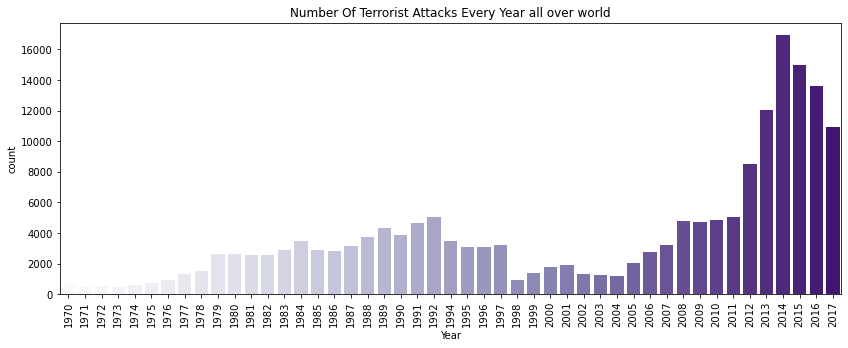

In [155]:
plt.subplots(figsize = (14,5))
sns.countplot('Year', data = df, palette = 'Purples')
plt.xticks(rotation = 90)
plt.title('Number Of Terrorist Attacks Every Year all over world')
plt.show()

### Number Of Casualities in Terrorist attacks Every Year

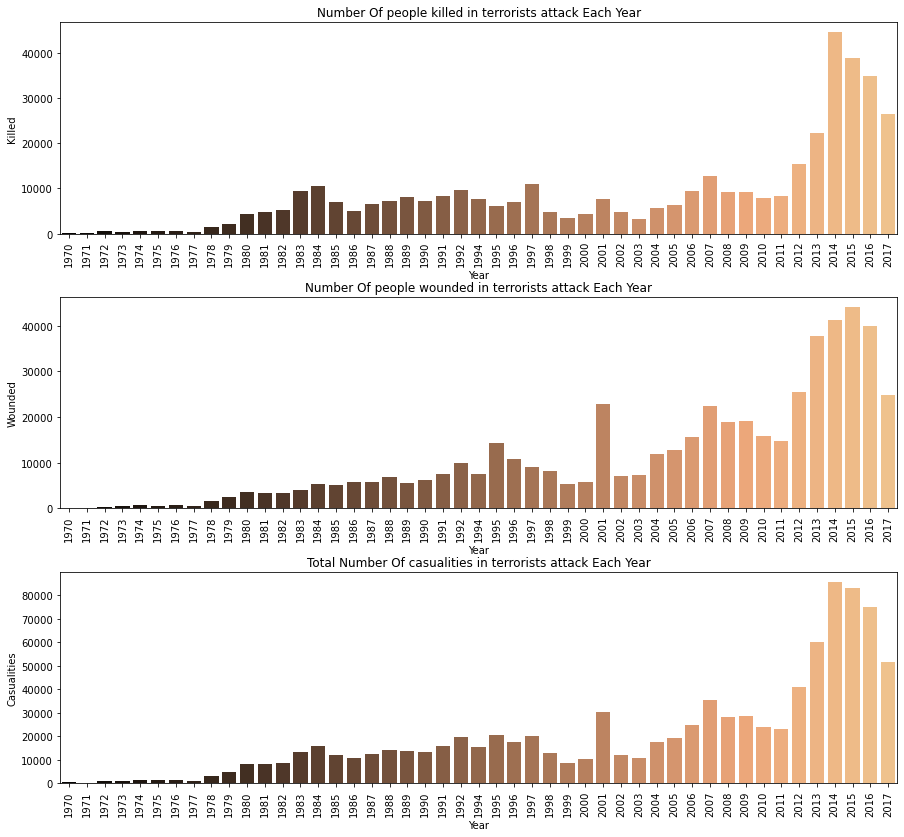

In [148]:
plt.subplots(figsize = (15,14))
plt.subplot(3, 1, 1)
year_killed = df.groupby('Year').Killed.sum().to_frame().reset_index()
year_killed.columns = ['Year','Killed']
sns.barplot(x = year_killed.Year, y = year_killed.Killed, palette = 'copper')
plt.xticks(rotation = 90)
plt.title('Number Of people killed in terrorists attack Each Year')
plt.subplots_adjust(hspace=.3)

plt.subplot(3, 1, 2)
year_wound = df.groupby('Year').Wounded.sum().to_frame().reset_index()
year_wound.columns = ['Year','Wounded']
sns.barplot(x = year_wound.Year, y = year_wound.Wounded, palette = 'copper')
plt.xticks(rotation = 90)
plt.title('Number Of people wounded in terrorists attack Each Year')

plt.subplot(3, 1, 3)
df['Casualities'] = df.Killed + df.Wounded
year_casual = df.groupby('Year').Casualities.sum().to_frame().reset_index()
year_casual.columns = ['Year','Casualities']
sns.barplot(x = year_casual.Year, y = year_casual.Casualities, palette = 'copper')
plt.xticks(rotation = 90)
plt.title('Total Number Of casualities in terrorists attack Each Year')


plt.show()


### Number of terrorists attacks succeeded vs failed each year

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46]),
 <a list of 47 Text major ticklabel objects>)

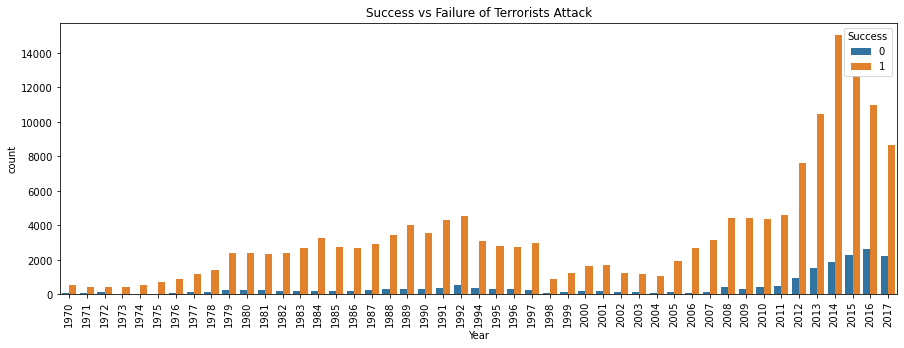

In [157]:
plt.figure(figsize=(15,5))
sns.countplot(x = "Year", hue = "Success", data = df)
plt.title("Success vs Failure of Terrorists Attack")
plt.xticks(rotation = 90)

### Total Number of terrorists attacks in each country
Highest in Iran 

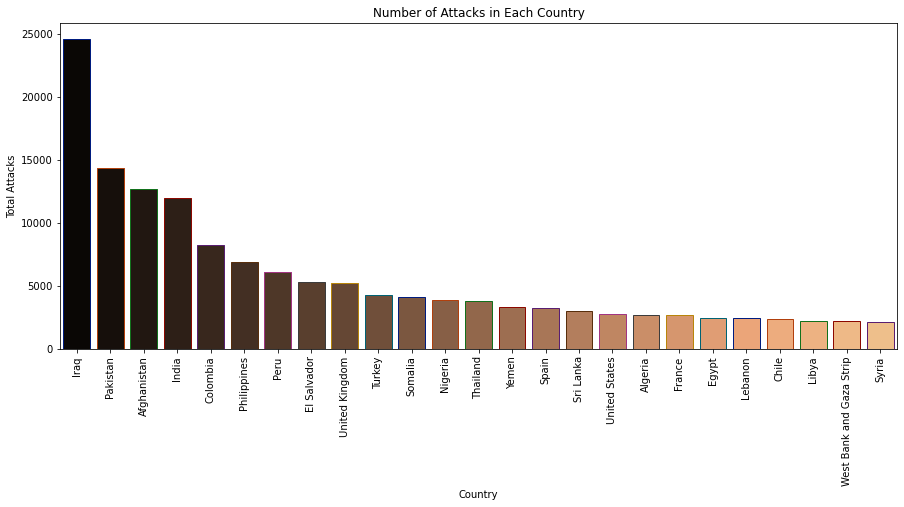

In [164]:
plt.subplots(figsize=(15,6))
country_attacks = df.Country.value_counts()[:25].reset_index()
country_attacks.columns = ['Country', 'Total Attacks']
sns.barplot(x = country_attacks.Country, y = country_attacks['Total Attacks'], palette= 'copper',edgecolor = sns.color_palette('dark',10))
plt.xticks(rotation=90)
plt.title('Number of Attacks in Each Country')
plt.show()

#### More than 50% of terrorists attacks across globe took place in Iraq and South Asian Countries

In [159]:
country_attacks = df.Country.value_counts()[:15].reset_index()
country_attacks.columns = ['Country', 'Total Attacks']
px.pie(country_attacks, names = "Country", values = "Total Attacks", title = "Percentage of Attacks in each country")

#### Number of casualities in each country due to terrorists attack

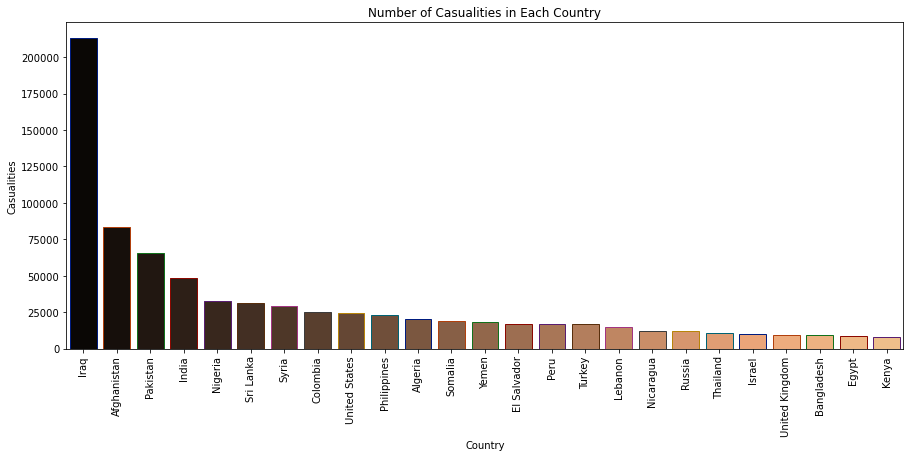

In [165]:
plt.subplots(figsize = (15,6))
count_cas = df.groupby('Country').Casualities.sum().to_frame().reset_index().sort_values('Casualities', ascending=False)[:25]
sns.barplot(x = count_cas.Country, y = count_cas.Casualities, palette =  'copper',edgecolor = sns.color_palette('dark',10))
plt.xticks(rotation=90)
plt.title('Number of Casualities in Each Country')
plt.show()

#### Number of terrorists attacks in each region

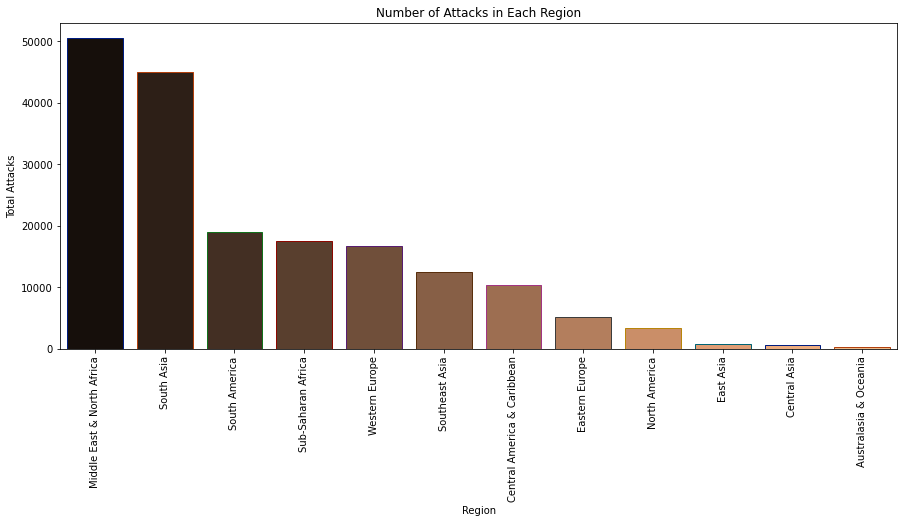

In [166]:
region_attacks = df.Region.value_counts().to_frame().reset_index()
region_attacks.columns = ['Region', 'Total Attacks']
plt.subplots(figsize = (15,6))
sns.barplot(x = region_attacks.Region, y = region_attacks['Total Attacks'], palette = 'copper', edgecolor = sns.color_palette('dark',10))
plt.xticks(rotation = 90)
plt.title('Number of Attacks in Each Region')
plt.show()

#### More than 52% terrorists attacks are in Middle East , North Africa and South Asia

In [162]:
px.pie(region_attacks, names = "Region", values = "Total Attacks", title = "Percentage of terrorists attack in each region")

#### Number of casualities in Each region

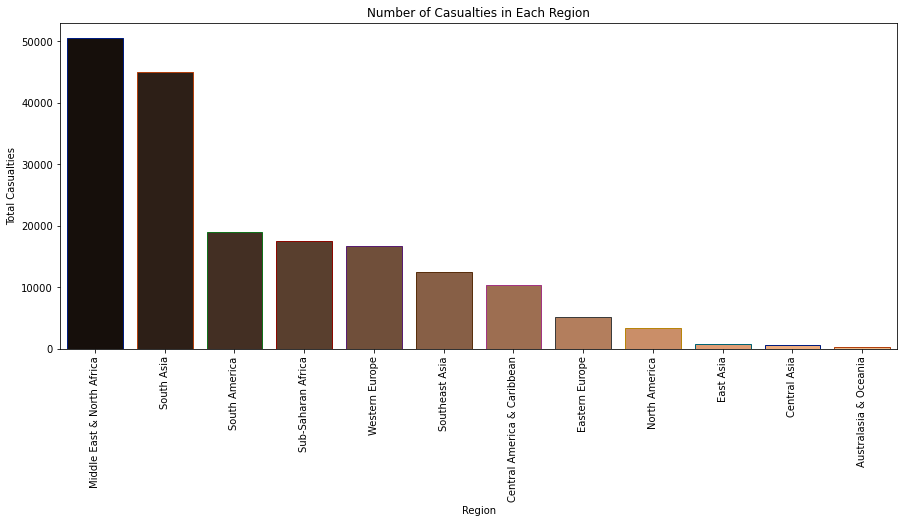

In [167]:
region_casualties = df.Region.value_counts().to_frame().reset_index()
region_casualties.columns = ['Region', 'Total Casualties']
plt.subplots(figsize = (15,6))
sns.barplot(x = region_casualties.Region, y = region_casualties['Total Casualties'], palette = 'copper', edgecolor = sns.color_palette('dark',10))
plt.xticks(rotation = 90)
plt.title('Number of Casualties in Each Region')
plt.show()

#### Percentage of casualities with specific weapons

In [169]:
px.pie(df, names = "AttackType", values = "Casualities", title = "Percentage of casualities with specific Weapon")

#### Percentage of kills based on different targets

In [172]:
px.pie(df, names = "Target_type", values = "Killed", title = "Percentage of kills based on different targets")

#### Most affected Top10 cities from terrorists attack

In [178]:
city = df['City'].value_counts()[1:10]
city

Baghdad         7589
Karachi         2652
Lima            2359
Mosul           2265
Belfast         2171
Santiago        1621
Mogadishu       1581
San Salvador    1558
Istanbul        1048
Name: City, dtype: int64